### Подключение библиотек

In [1]:
import pandas as pd
import pickle
import yfinance as yf
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

### Raw data
#### Dow Jones, FTSE 100, NASDAQ, S&P 500

In [2]:
tickers_dow = sorted(['UNH', 'MSFT', 'GS', 'HD', 'AMGN', 'MCD', 'CAT', 'CRM', 'BA', 'TRV', 'HON', 'V', 'AAPL', 'AXP', 'IBM', 'JPM', 'JNJ', 'WMT', 'PG', 'CVX', 'MRK', 'MMM', 'NKE', 'DIS', 'KO', 'DOW', 'CSCO', 'INTC', 'VZ', 'WBA'])

df_ftse = pd.read_csv("ftse.csv", header=None)
tickers_ftse = list(df_ftse[0])

df_nasdaq = pd.read_csv("nasdaq.txt", header=None)
tickers_nasdaq = list(df_nasdaq[0])

df_snp = pd.read_csv("snp.csv", header=None)
tickers_snp = list(df_snp[0])

tickers_dict = {
    "dow": tickers_dow,
    "ftse": tickers_ftse,
    "nasdaq": tickers_nasdaq,
    "snp": tickers_snp
}

pickle.dump(tickers_dict, open("tickers_dict.pkl", "wb"))

### Dataframe

In [3]:
list_dow = [["DOW", item] for item in tickers_dow]
list_ftse = [["FTSE", item] for item in tickers_ftse]
list_nasdaq = [["NASDAQ", item] for item in tickers_nasdaq]
list_snp = [["S&P", item] for item in tickers_snp]

In [4]:
df = pd.DataFrame(list_dow + list_ftse + list_nasdaq + list_snp, columns=["Index", "Ticker"])
df

,Index,Ticker
0,DOW,AAPL
1,DOW,AMGN
2,DOW,AXP
3,DOW,BA
4,DOW,CAT
...,...,...
722,S&P,MHK
723,S&P,PARA
724,S&P,VFC
725,S&P,FOX


In [5]:
df.to_csv("tickers_df.csv", index=False)  

### Выгрузка акций через yfinance

Выгрузим в периоде от 1 января 2020 года до 1 января 2024 года. Понятно, что некоторые акции могли не существовать в этот период.

В итоге мы получим матрицу $n \times m$, где $n~-$ количество дней, а $m~-$ количество акций

In [82]:
start_date = '2020-01-01'
end_date = '2024-01-01'

tickers = df['Ticker'].unique().tolist()
price_data = yf.download(tickers, start=start_date, end=end_date, auto_adjust=False)['Adj Close']

[*********************100%***********************]  608 of 608 completed

13 Failed downloads:
['PXD', 'SPLK', 'WRK', 'PEAK', 'FLT', 'BDEV.L', 'CPG', 'ICP.L']: YFTzMissingError('possibly delisted; no timezone found')
['CTLT', 'FRES', 'MRO', 'SMDS.L']: YFPricesMissingError('possibly delisted; no price data found  (1d 2020-01-01 -> 2024-01-01) (Yahoo error = "No data found, symbol may be delisted")')
['SPXSY']: YFPricesMissingError('possibly delisted; no price data found  (1d 2020-01-01 -> 2024-01-01) (Yahoo error = "Data doesn\'t exist for startDate = 1577854800, endDate = 1704085200")')


Посмотрим на наличие пропусков: сколько пропусков у каждой акции, и удалим акции с достаточно большим числом пропусков. 

In [83]:
cnt_nans = price_data.isna().sum()
print(cnt_nans)
filtered = cnt_nans[cnt_nans > 24] # was 24
filtered_columns = price_data[filtered.index].columns
print(filtered_columns)

Ticker
A        24
AAF.L    22
AAL      24
AAPL     24
ABBV     24
         ..
ZBH      24
ZBRA     24
ZION     24
ZS       24
ZTS      24
Length: 608, dtype: int64
Index(['ABNB', 'BDEV.L', 'CARR', 'CEG', 'CPG', 'CTEC', 'CTLT', 'DASH', 'DGE',
       'FLT', 'FRES', 'GEHC', 'GFS', 'HIK', 'ICP.L', 'KVUE', 'MNG', 'MRO',
       'OTIS', 'PEAK', 'PXD', 'RKT', 'SKG', 'SMDS.L', 'SPLK', 'SPXSY', 'VLTO',
       'WRK'],
      dtype='object', name='Ticker')


In [84]:
price_data = price_data.drop(columns=filtered_columns)

In [85]:
price_data

Ticker,A,AAF.L,AAL,AAPL,ABBV,ABT,ACGL,ACN,ADBE,ADI,...,XEL,XOM,XRAY,XYL,YUM,ZBH,ZBRA,ZION,ZS,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2020-01-02,82.885262,78.745361,28.982893,72.716072,70.934250,78.908432,41.268997,193.477844,334.429993,109.436241,...,53.112019,55.137970,52.434689,75.007904,92.652496,139.014832,259.140015,43.711166,47.330002,128.386215
2020-01-03,81.554459,78.445564,27.548195,72.009117,70.260941,77.946457,41.221451,193.155624,331.809998,107.509750,...,53.367443,54.694706,51.854424,75.449417,92.362305,138.651428,256.049988,43.094337,47.380001,128.405380
2020-01-06,81.795547,78.395599,27.219410,72.582901,70.815422,78.354836,41.383106,191.894318,333.709991,106.246628,...,53.290821,55.114651,52.139957,74.960938,92.307915,137.850128,258.010010,42.569202,48.700001,127.419563
2020-01-07,82.046272,79.245018,27.119778,72.241562,70.411446,77.919228,41.040779,187.751328,333.390015,108.663834,...,53.180122,54.663589,52.416267,74.679131,92.471130,137.729034,256.470001,42.310806,48.400002,127.850258
2020-01-08,82.856339,77.696091,27.737495,73.403656,70.910469,78.236847,40.631893,188.119614,337.869995,109.645233,...,53.129044,53.839237,52.968880,74.932755,92.634369,139.378204,247.639999,42.727581,50.750000,127.572701
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,138.080856,129.500000,14.310000,192.444580,146.723526,105.848419,70.214340,345.652008,598.750000,192.972656,...,58.772797,97.674713,33.840988,111.066032,126.863899,119.038544,269.410004,42.116344,221.679993,191.838577
2023-12-26,138.318283,NaN,14.110000,191.897858,146.420517,106.042580,69.900551,344.657318,598.260010,194.705566,...,58.952732,97.895142,34.148453,112.032349,127.117630,120.126839,275.500000,42.958675,224.589996,192.350204
2023-12-27,138.328201,129.800003,13.990000,191.997269,146.666718,106.586235,69.929077,345.037598,596.080017,195.175537,...,58.771275,97.435097,34.234940,112.781715,127.683624,119.839928,275.790009,42.604511,225.020004,193.727600


Заполним пропуски, используя forward fill и backward fill. Первый метод заполняет ближайшим предыдущим непустым значением, а второй метод заполняет следующим ближайшим непустым значением. Также удалим акции, которые полностью состоят из пропусков (они могли не торговаться в данный период)

In [86]:
price_data = price_data.replace([np.inf, -np.inf], np.nan)
price_data = price_data.fillna(method='ffill').fillna(method='bfill')
price_data = price_data.dropna(axis=1)
print(price_data.isna().sum())

Ticker
A        0
AAF.L    0
AAL      0
AAPL     0
ABBV     0
        ..
ZBH      0
ZBRA     0
ZION     0
ZS       0
ZTS      0
Length: 580, dtype: int64


/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/190848069.py:2: FutureWarning:

DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



Затем удалим активы, которые оставались константными на протяжение всего времени. Скорее всего они удалились при предыдущей очистке, но все равно. Они нам будут мешать, потому что планируется подсчет кореляции между разными активами, и для подсчета будет считаться стандартное отклонение, которое будет равно 0 и которое будет в знаменателе

In [87]:
constant_columns = price_data.columns[price_data.nunique() == 1]
print(constant_columns)
price_data = price_data.drop(columns=constant_columns)

Index([], dtype='object', name='Ticker')


In [88]:
# threshold = 0.2
# returns = price_data.pct_change()
# returns = returns.iloc[1:]
# zero_percentage = (returns == 0).sum() / len(returns)
# index_remove = zero_percentage[zero_percentage > threshold].index
# # filtered_portfolio_returns = returns.drop(columns=index_remove)
# index_remove

### Расчет метрик: равномерный бейзлайн $\\$

Каждая доля акций в портфеле будет составлять одинаковое значение.

Напомним, что price_data $\in R^{n \times m}$

Посчитаем матрицу returns $\in R^{(n - 1) \times m}$, где в $i$ строчке будет записано процентное изменение цены с $i$ до $i+1$

Затем посчитаем среднюю доходность за весь период у каждой акции и запишем в mean_returns $\in R^m$

Затем мы считаем скалярное произведение вектора весов и среднюю доходность, получим доходность всего портфеля, обозначим это как portfolio_returns

Затем посчитаем волатильность и индекс Шарпа:

1. Считается ковариационная матрица доходностей. Она показывает как доходность актива меняется относительно друг друга

2. Затем считается волатильность портфеля через матричный вид $w^t \Sigma w$, где $w~-$ вектор весов, а $\Sigma~-$ наша ковариационная матрица, где $\Sigma_{ij}$ означает ковариацию между $i$ и $j$ столбцом у матрицы returns. Если развернуть это формулу, то получим $\sum\limits_{i=1}^{m}\sum\limits_{j=1}^{m} w_i w_j \Sigma_{ij}$. И затем надо взять корень чтобы получить волатильность

3. Индекс шарпа с безрисковой ставкой 2%

In [89]:
returns = price_data.pct_change()
returns = returns.iloc[1:]

# num_assets = price_data.shape[1]
# weights = np.full(num_assets, 1 / num_assets)

# mean_returns = returns.mean(axis=0)
# portfolio_returns = np.dot(weights, mean_returns)

# cov_matrix = returns.cov()
# portfolio_volatility = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
# risk_free_rate = 0.02
# sharpe_ratio = (portfolio_returns - risk_free_rate) / portfolio_volatility

# print(f"Средняя доходность портфеля: {portfolio_returns * 100}")
# print(f"Волатильность портфеля: {portfolio_volatility}")
# print(f"Коэффициент Шарпа: {sharpe_ratio:.2f}")

### Случайный бейзлайн из равномерного распределения

Каждая доля будет генерироваться из равномерного распределения от $0$ до $1$

In [90]:
# random_weights = np.random.rand(num_assets) 
# random_weights /= random_weights.sum()

# mean_returns = returns.mean(axis=0)
# portfolio_returns = np.dot(random_weights, mean_returns)

# cov_matrix = returns.cov()
# portfolio_volatility = np.sqrt(np.dot(random_weights.T, np.dot(cov_matrix, random_weights)))
# risk_free_rate = 0.02
# sharpe_ratio = (portfolio_returns - risk_free_rate) / portfolio_volatility

# print(f"Средняя доходность портфеля: {portfolio_returns * 100}")
# print(f"Волатильность портфеля: {portfolio_volatility}")
# print(f"Коэффициент Шарпа: {sharpe_ratio:.2f}")

In [91]:
from scipy.linalg import eigh
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

def build_weight_matrix(returns):
    # matrix = returns.to_numpy()
    # columns_with_nans = np.where(np.isnan(matrix).any(axis=0))[0]
    # print("NaN values:", columns_with_nans)
    # row_sums = returns.sum(axis=1)
    # print("Row sums:", row_sums)
    # print("Any NaN in row sums:", np.isnan(row_sums).any())
    # W = np.array(returns)
    # row_sums = W.sum(axis=1)
    # print("Row sums:", row_sums)
    # print("Data type of row sums:", row_sums.dtype)
    # constant_columns = returns.columns[returns.nunique() == 1]
    # print(constant_columns)
    corr = returns.corr().abs()
    # np.fill_diagonal(corr.values, 0)
    return corr.values

def compute_laplacian_matrix(W):
    D = np.diag(W.sum(axis=1))
    L = D - W
    # print("W is", W)
    # print("D is", D)
    # print("Lap is", L)
    return L

def spectral_clustering(L):
    # print("L is", L)
    eigenvalues, eigenvectors = eigh(L, subset_by_index=[1, 1])
    fiedler_vector = eigenvectors[:, 0]

    cluster_1 = np.where(fiedler_vector > 0)[0]
    cluster_2 = np.where(fiedler_vector <= 0)[0]
    return cluster_1, cluster_2

def allocate_capital_between_clusters(num_clusters, method="equal"):
    if method == "equal":
        weights = np.ones(num_clusters) / num_clusters
    elif method == "hierarchical":
        # print('num_clusters', num_clusters)
        weights = 1 / (2 ** np.arange(1, num_clusters + 1))
        # print(weights)
        # print(weights.sum())
        # по дефолту 1 
        weights /= weights.sum()
    else:
        raise ValueError("Unknown allocation method")
    return weights

def allocate_within_cluster(cluster, total_weight):
    num_assets = len(cluster)
    if num_assets == 0:
        return np.array([])
    return np.full(num_assets, total_weight / num_assets)

def recursive_clustering(W, num_clusters):
    clusters = [np.arange(W.shape[0])]

    while len(clusters) < num_clusters:
        largest_cluster_idx = np.argmax([len(cluster) for cluster in clusters])
        largest_cluster = clusters.pop(largest_cluster_idx)

        sub_W = W[np.ix_(largest_cluster, largest_cluster)]
        sub_L = compute_laplacian_matrix(sub_W)

        cluster_1, cluster_2 = spectral_clustering(sub_L)

        clusters.append(largest_cluster[cluster_1])
        clusters.append(largest_cluster[cluster_2])

    return clusters

def visualize_clusters(W, clusters):
    G = nx.Graph()
    num_nodes = W.shape[0]

    for i in range(num_nodes):
        G.add_node(i)

    for i in range(num_nodes):
        for j in range(i + 1, num_nodes):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    cluster_colors = []
    for i, cluster in enumerate(clusters):
        cluster_colors.extend([i] * len(cluster))

    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels=True, node_color=cluster_colors, cmap=plt.cm.tab10, node_size=500, edge_color="gray")
    plt.show()

def portfolio_optimization(price_data, num_clusters=2, method="equal", visualize=False):
    returns = price_data.pct_change().iloc[1:]

    W = build_weight_matrix(returns)
    # W2 = np.array(W)
    # print("W2 is", W2)
    # row_sums = W2.sum(axis=1)
    # print("Row sums:", row_sums)
    # print("Data type of row sums:", row_sums.dtype)
    
    clusters = recursive_clustering(W, num_clusters)

    if visualize:
        visualize_clusters(W, clusters)

    # print('clusters:', clusters)
    cluster_weights = allocate_capital_between_clusters(len(clusters), method)
    # print('cluster_weights:', cluster_weights)

    final_weights = np.zeros(W.shape[0])
    for i, cluster in enumerate(clusters):
        weights_cluster = allocate_within_cluster(cluster, cluster_weights[i])
        # print('weights_cluster:', weights_cluster)
        final_weights[cluster] = weights_cluster

    return final_weights


def kmeans_clustering(W, num_clusters):
    kmeans = KMeans(n_clusters=num_clusters, random_state=42).fit(W)
    labels = kmeans.labels_
    
    clusters = [np.where(labels == i)[0] for i in range(num_clusters)]
    
    return clusters


def portfolio_optimization_with_kmeans(price_data, num_clusters, method="equal"):
    returns = price_data.pct_change().iloc[1:]

    W = build_weight_matrix(returns)
    
    clusters = kmeans_clustering(W, num_clusters)

    cluster_weights = allocate_capital_between_clusters(len(clusters), method)

    final_weights = np.zeros(W.shape[0])
    for i, cluster in enumerate(clusters):
        weights_cluster = allocate_within_cluster(cluster, cluster_weights[i])
        final_weights[cluster] = weights_cluster

    return final_weights

In [92]:
np.random.seed(42)
# price_data = pd.DataFrame(np.random.rand(10000, 600) * 100)

num_clusters = 60
final_weights = portfolio_optimization(price_data, num_clusters=num_clusters, method="hierarchical", visualize=False)

print("Финальное распределение капитала по активам:")
print(final_weights)

Финальное распределение капитала по активам:
[4.27008856e-18 5.58035714e-04 6.35782878e-07 5.68434189e-14
 8.41864224e-06 8.41864224e-06 3.66731735e-15 7.45058060e-09
 5.68434189e-14 4.27008856e-18 3.66731735e-15 6.31593543e-15
 4.27008856e-18 2.99090254e-20 2.99090254e-20 4.76837158e-08
 2.91038305e-12 3.55271368e-15 4.78544407e-19 1.49011612e-08
 2.38418579e-07 2.77555756e-17 7.10542736e-15 4.27008856e-18
 3.66731735e-15 2.86509168e-17 4.27008856e-18 9.70127682e-12
 5.68434189e-14 2.86509168e-17 8.41864224e-06 2.86509168e-17
 8.41864224e-06 5.68434189e-14 1.56809431e-14 5.68434189e-14
 5.58035714e-04 1.11022302e-16 9.31322575e-10 2.44140625e-04
 6.31593543e-15 5.19711258e-13 2.06960572e-10 2.50966925e-08
 6.97544643e-05 8.41864224e-06 4.59558824e-04 1.04166667e-03
 2.50966925e-08 4.27008856e-18 9.70127682e-12 2.99090254e-20
 1.56809431e-14 4.78544407e-19 2.48352687e-10 2.48352687e-10
 5.55111512e-18 1.04166667e-03 4.78544407e-19 9.09494702e-13
 1.04166667e-03 6.25000000e-03 8.4186422

In [93]:
# mean_returns = returns.mean(axis=0)
# portfolio_returns = np.dot(final_weights, mean_returns)

# cov_matrix = returns.cov()
# portfolio_volatility = np.sqrt(np.dot(final_weights.T, np.dot(cov_matrix, final_weights)))
# risk_free_rate = 0.02
# sharpe_ratio = (portfolio_returns - risk_free_rate) / portfolio_volatility

# print(f"Средняя доходность портфеля: {portfolio_returns * 100}")
# print(f"Волатильность портфеля: {portfolio_volatility}")
# print(f"Коэффициент Шарпа: {sharpe_ratio:.2f}")

In [94]:
def plot_cumulative_returns(stocks=None):
    if stocks != None:
        data = price_data[stocks]
    else:
        data = price_data
    returns = data.pct_change()
    returns = returns.iloc[1:]

    port_comps_rets_cumprod = returns.add(1).cumprod().subtract(1).multiply(100)

    fig = px.line(port_comps_rets_cumprod,
                x=port_comps_rets_cumprod.index,
                y=port_comps_rets_cumprod.columns,
                title='Cumulative Returns of Portfolio Stocks (2020-2024)')

    fig.update_xaxes(title_text='Date')
    fig.update_yaxes(title_text='Cumulative Return in %')
    fig.update_layout(
        width=1600,
        height=800
    )

    fig.show()
plot_cumulative_returns()

Разделим выборку на обучающую и тестовую. Обучающая будет включать в себя данные до 30 июля 2022 года, а тестовая$~-$ остальное. Исходя из обучающей выборке посчитаем параметры $\mu$ и $\Sigma$, которые обозначают вектор ожидаемых доходностей и ковариационная матрица доходностей соответственно.

In [95]:
from pypfopt import risk_models
from pypfopt import expected_returns
from pypfopt.expected_returns import ema_historical_return
from pypfopt.risk_models import exp_cov
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt.plotting import plot_efficient_frontier
from pypfopt.plotting import plot_weights
from pypfopt.cla import CLA

train = returns[:'2022-07-30']
test = returns['2022-07-31':]

mu = expected_returns.ema_historical_return(train, returns_data = True, span = 500)
Sigma = risk_models.exp_cov(train, returns_data = True, span = 180)
print('mu:', mu)
print('Sigma:', Sigma)

mu: Ticker
A        0.128097
AAF.L    0.711449
AAL     -0.085031
AAPL     0.286250
ABBV     0.267102
           ...   
ZBH     -0.110211
ZBRA    -0.038404
ZION     0.109964
ZS       0.075670
ZTS      0.078487
Name: 2022-07-29 00:00:00, Length: 580, dtype: float64
Sigma: Ticker         A     AAF.L       AAL      AAPL      ABBV       ABT      ACGL  \
Ticker                                                                         
A       0.115434  0.012360  0.062032  0.069778  0.015701  0.058895  0.033010   
AAF.L   0.012360  0.164734  0.052069  0.022577  0.006057  0.014761  0.033483   
AAL     0.062032  0.052069  0.371159  0.115650  0.010517  0.063906  0.062849   
AAPL    0.069778  0.022577  0.115650  0.109509  0.011607  0.049185  0.032192   
ABBV    0.015701  0.006057  0.010517  0.011607  0.049675  0.024530  0.013787   
...          ...       ...       ...       ...       ...       ...       ...   
ZBH     0.048398  0.016203  0.090429  0.050262  0.015999  0.044138  0.033783   
ZBRA    0

Затем подадим эти два параметра в класс EfficientFrontier из библиотеки PyPortfolioOpt и посмотрим на метрики и распределение весов, когда мы минимизируем волатильность

{'FLTR': 0.9101551742766848, 'EDV': 0.0195471359358571, 'BAX': 0.0102735708776719, 'BA.L': 0.0091732253851057, 'UU.L': 0.0087694518341301, 'ULVR.L': 0.0086622716907166, 'PSON.L': 0.0084466814927566, 'LSEG.L': 0.0081921650482921, 'SVT': 0.007989916155733, 'BATS.L': 0.004487218170467, 'CF': 0.002727005379173, 'CME': 0.0018311418465392, 'JNJ': 0.0012026163010358, 'PHNX.L': 0.0010186397085134, 'BNZL.L': 0.0007790361269578, 'AV.L': 1.51872723866e-05, 'K': 1.4967163322e-06, 'BEZ.L': 1.1779812479e-06, 'GIS': 6.768502355e-07, 'BT-A.L': 5.391046228e-07, 'CAG': 4.795927088e-07, 'KHC': 4.167509121e-07, 'NEM': 3.693393488e-07, 'CPB': 2.769785777e-07, 'BKY.L': 2.643817376e-07, 'HRL': 2.072977059e-07, 'HSBA.L': 1.943663019e-07, 'SJM': 1.55665435e-07, 'NOC': 1.320716929e-07, 'IMB.L': 1.130038771e-07, 'WEC': 8.78526545e-08, 'MRK': 8.65958645e-08, 'DUK': 7.81943547e-08, 'LMT': 6.63001331e-08, 'CHD': 3.17520384e-08, 'GLEN.L': 1.23855474e-08, 'KR': -1.47612071e-08, 'ABBV': -3.88025704e-08, 'D': -5.223824

(np.float64(-0.0023935880281403393),
 np.float64(0.025270989224931675),
 np.float64(-3.656112833801825))

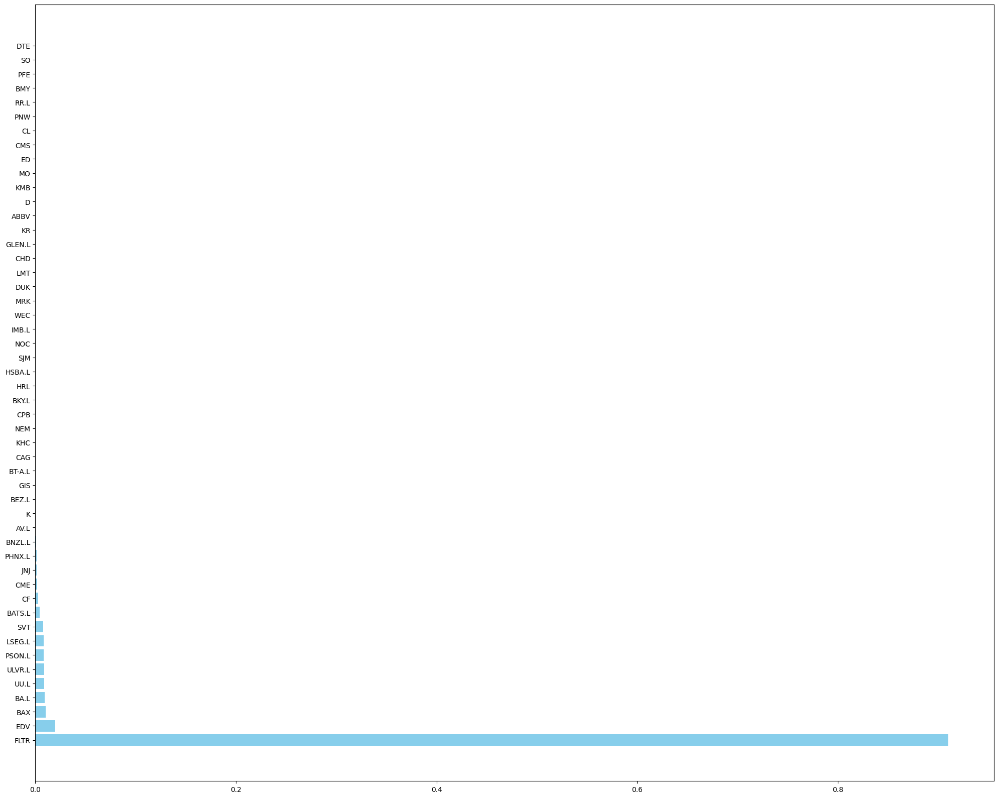

In [96]:
ef = EfficientFrontier(mu, Sigma)
raw_weights_minvar_exp = ef.min_volatility()

sorted_weights = {k: v for k, v in sorted(raw_weights_minvar_exp.items(), key=lambda item: item[1], reverse=True)}
top_50_weights = dict(list(sorted_weights.items())[:50])

print(top_50_weights)
assets = list(top_50_weights.keys())
weights = list(top_50_weights.values())

fig, ax = plt.subplots(figsize=(20, 16))
ax.barh(assets, weights, color='skyblue')
plt.tight_layout()

min_vol_ret = ef.portfolio_performance()[0]
min_vol_vol = ef.portfolio_performance()[1]
ef.portfolio_performance(verbose=True, risk_free_rate=0.09)

Аналогично сделаем с максимизацией соотношения Шарпа. И, действительно, у нас волатильность стала сильно выше по сравнению с предыдущим методом, который минимизирует волатильность

{'MCK': 0.2336496629114744, 'K': 0.1177494361354208, 'ENPH': 0.1123154416854001, 'EQT': 0.0845760535333855, 'BA.L': 0.0793081325049262, 'LLY': 0.0768946904041039, 'AAF.L': 0.0726503085737417, 'OXY': 0.0540746257052559, 'FRAS.L': 0.0492591411205596, 'SVT': 0.045993935018041, 'BEZ.L': 0.0421525474792015, 'BKY.L': 0.0309445017467124, 'III': 0.0155059857214008, 'UU.L': 0.0003207931820598, 'PSON.L': -2.4572504687e-06, 'ABBV': -2.4752052796e-06, 'CF': -3.0765325087e-06, 'EDV': -3.1288734954e-06, 'DVN': -3.4954436723e-06, 'GIS': -3.5725788966e-06, 'FLTR': -3.6553732738e-06, 'ED': -3.8415371843e-06, 'MRK': -4.1735302116e-06, 'SO': -4.6007902619e-06, 'HSY': -4.9515152172e-06, 'BNZL.L': -5.4881844488e-06, 'ULVR.L': -5.5121699785e-06, 'DUK': -5.7714669291e-06, 'LSEG.L': -5.9865412297e-06, 'BMY': -6.288792687e-06, 'NOC': -6.4038154191e-06, 'WEC': -6.4777127041e-06, 'HRL': -6.5541294791e-06, 'JNJ': -6.7001717633e-06, 'CHD': -6.8397234038e-06, 'CPB': -7.0127095044e-06, 'KMB': -7.0526535427e-06, 'EXC

/Users/kiruxalight/course_work/course_work/lib/python3.12/site-packages/cvxpy/problems/problem.py:1504: UserWarning:

Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.



(np.float64(0.7910928237004313),
 np.float64(0.1854423881232638),
 np.float64(3.780650318385751))

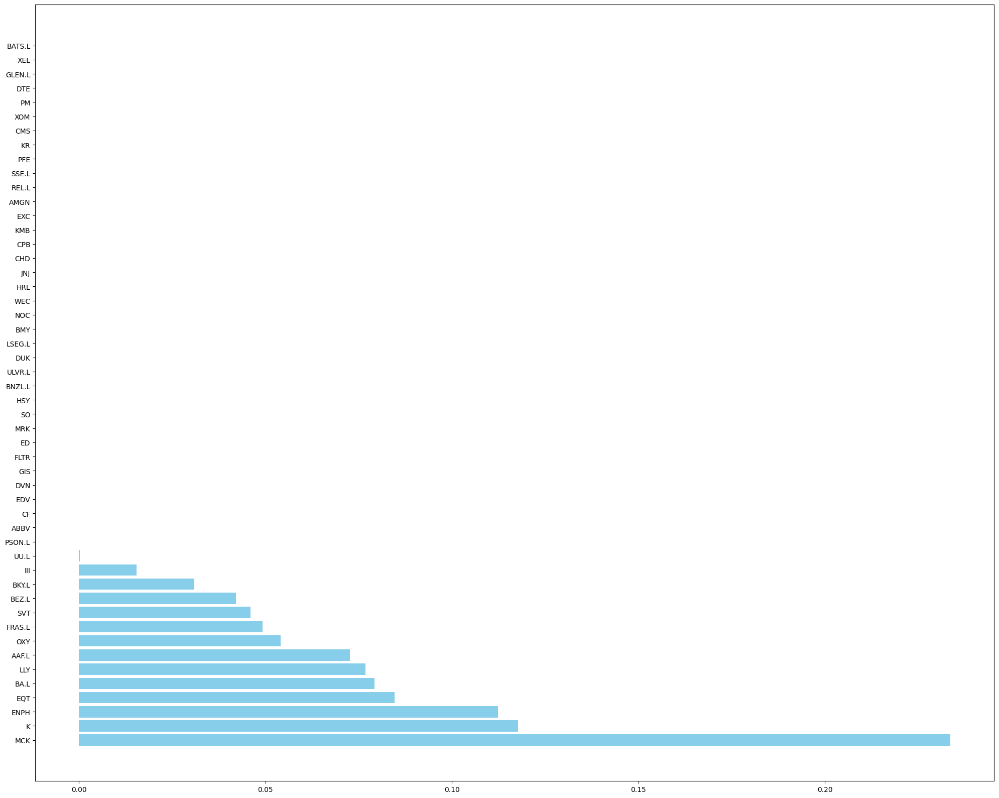

In [97]:
ef = EfficientFrontier(mu, Sigma)
raw_weights_maxsharpe_exp = ef.max_sharpe(risk_free_rate=0.09)

sorted_weights = {k: v for k, v in sorted(raw_weights_maxsharpe_exp.items(), key=lambda item: item[1], reverse=True)}
top_50_weights = dict(list(sorted_weights.items())[:50])

print(top_50_weights)
assets = list(top_50_weights.keys())
weights = list(top_50_weights.values())

fig, ax = plt.subplots(figsize=(20, 16))
ax.barh(assets, weights, color='skyblue')
plt.tight_layout()

max_sharpe_ret = ef.portfolio_performance(risk_free_rate=0.09)[0]
max_sharpe_vol = ef.portfolio_performance(risk_free_rate=0.09)[1]
print(max_sharpe_ret)
ef.portfolio_performance(verbose=True, risk_free_rate=0.09)

### Бектестинг

In [98]:
print(len(raw_weights_maxsharpe_exp))
print(train.shape)
print(test.shape)

580
(664, 580)
(365, 580)


In [99]:
num_clusters_array = [3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 17, 20, 22, 25, 27, 30, 33, 36, 38, 40, 43, 47, 50, 53, 57, 60]
results_hierarchical = []
for num_clusters in num_clusters_array:
    final_weights = portfolio_optimization(train, num_clusters=num_clusters, method="hierarchical", visualize=False)
    return_cluster = test.dot(final_weights).add(1).cumprod().subtract(1).multiply(100)
    res = return_cluster[-1]
    results_hierarchical.append(res)

print(results_hierarchical)

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/3842579398.py:6: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



[np.float64(15.371441480274894), np.float64(14.790030541910081), np.float64(15.281523039954049), np.float64(15.260606834818734), np.float64(15.19915898268942), np.float64(15.21785892573293), np.float64(15.238402834157627), np.float64(15.25501261296296), np.float64(15.257230870400008), np.float64(15.255316698662735), np.float64(15.256042180727935), np.float64(15.24858658669932), np.float64(17.72443222899358), np.float64(19.867046929488154), np.float64(20.343800928085052), np.float64(17.991181348643927), np.float64(19.06887446003318), np.float64(20.413177460060705), np.float64(22.773294587200343), np.float64(22.421376992443378), np.float64(22.421389624682586), np.float64(20.426878712156228), np.float64(16.690806792581814), np.float64(8.840125906429153), np.float64(8.840076916959806), np.float64(9.123131092754866), np.float64(1.8709294230467854)]


In [100]:
results_equal = []
for num_clusters in num_clusters_array:
    final_weights = portfolio_optimization(train, num_clusters=num_clusters, method="equal", visualize=False)
    return_cluster = test.dot(final_weights).add(1).cumprod().subtract(1).multiply(100)
    res = return_cluster[-1]
    results_equal.append(res)

print(results_equal)

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/50598602.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



[np.float64(14.240356858859005), np.float64(16.212185625943732), np.float64(16.507547425288305), np.float64(16.009397745151), np.float64(15.858862203078793), np.float64(16.499757429466744), np.float64(16.939469107300887), np.float64(17.569711855725178), np.float64(16.8865229951378), np.float64(16.944740710436257), np.float64(16.87365066609574), np.float64(17.054900810782627), np.float64(16.022652428787044), np.float64(15.22092353291944), np.float64(14.806207200664655), np.float64(15.346196920311272), np.float64(15.59843249691757), np.float64(15.67623691612734), np.float64(15.388764843892044), np.float64(16.255549618775824), np.float64(16.767511791973643), np.float64(17.07657157919542), np.float64(17.465343677083478), np.float64(17.528718946731225), np.float64(17.22346573694815), np.float64(16.777757803359904), np.float64(16.63050657060603)]


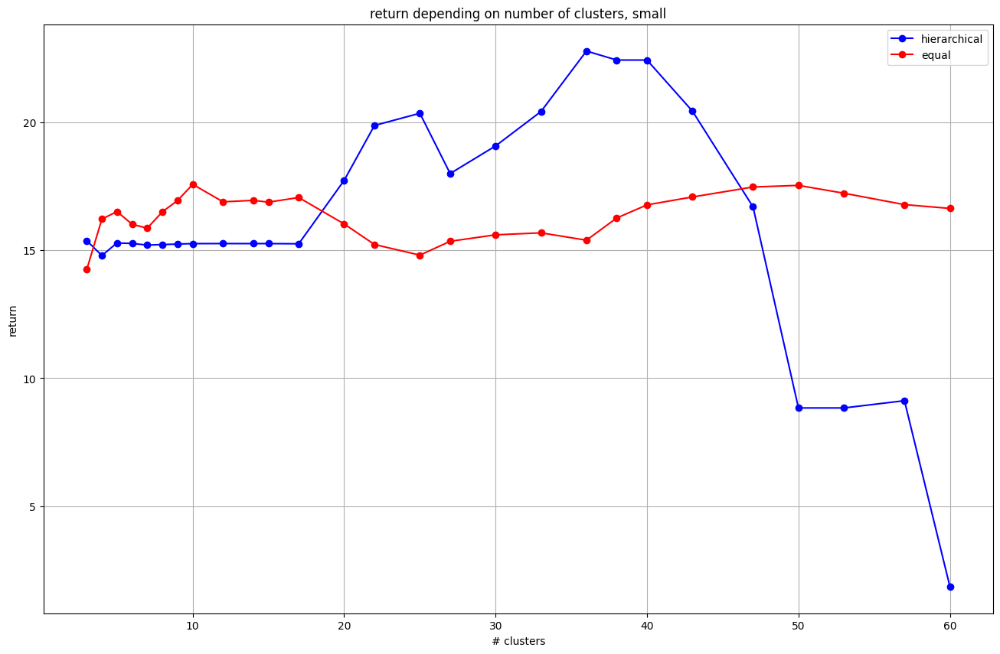

In [101]:
plt.figure(figsize=(16, 10))
plt.plot(num_clusters_array, results_hierarchical, marker='o', linestyle='-', color='b', label='hierarchical')
plt.plot(num_clusters_array, results_equal, marker='o', linestyle='-', color='r', label='equal')
plt.title('return depending on number of clusters, small')
plt.xlabel('# clusters')
plt.ylabel('return')
plt.grid(True)
plt.legend()
plt.show()

In [102]:
num_clusters_array_big = [3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 17, 20, 22, 25, 27, 30, 33, 36, 38, 40, 43, 47, 50, 53, 57, 60, 70, 80, 90,
                            100, 110, 120, 150, 170, 200, 250, 300, 400]

results_equal = []
for num_clusters in num_clusters_array_big:
    final_weights = portfolio_optimization(train, num_clusters=num_clusters, method="equal", visualize=False)
    return_cluster = test.dot(final_weights).add(1).cumprod().subtract(1).multiply(100)
    res = return_cluster[-1]
    results_equal.append(res)

print(results_equal)

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/2979592371.py:8: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



[np.float64(14.240356858859005), np.float64(16.212185625943732), np.float64(16.507547425288305), np.float64(16.009397745151), np.float64(15.858862203078793), np.float64(16.499757429466744), np.float64(16.939469107300887), np.float64(17.569711855725178), np.float64(16.8865229951378), np.float64(16.944740710436257), np.float64(16.87365066609574), np.float64(17.054900810782627), np.float64(16.022652428787044), np.float64(15.22092353291944), np.float64(14.806207200664655), np.float64(15.346196920311272), np.float64(15.59843249691757), np.float64(15.67623691612734), np.float64(15.388764843892044), np.float64(16.255549618775824), np.float64(16.767511791973643), np.float64(17.07657157919542), np.float64(17.465343677083478), np.float64(17.528718946731225), np.float64(17.22346573694815), np.float64(16.777757803359904), np.float64(16.63050657060603), np.float64(16.813480386924738), np.float64(17.672834247887526), np.float64(17.78132827118799), np.float64(17.366316867655772), np.float64(17.041503

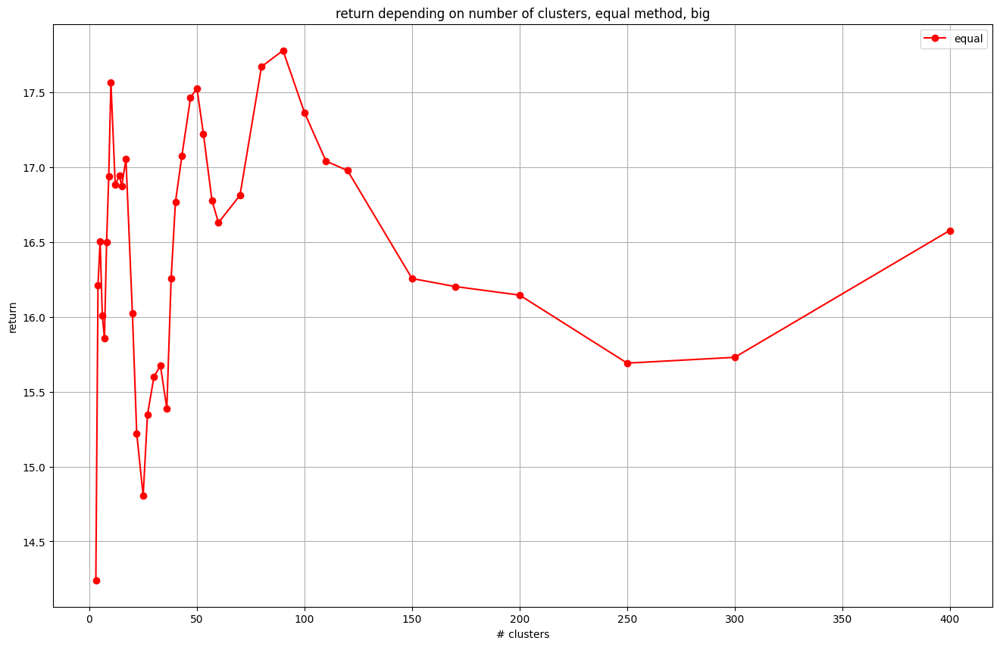

In [132]:
plt.figure(figsize=(16, 10))
plt.plot(num_clusters_array_big, results_equal, marker='o', linestyle='-', color='r', label='equal')
plt.title('return depending on number of clusters, equal method, big')
plt.xlabel('# clusters')
plt.ylabel('return')
plt.grid(True)
plt.legend()
plt.show()

In [104]:
results_kmeans_hierarchical = []
for num_clusters in num_clusters_array:
    final_weights_kmeans_hierarchical = portfolio_optimization_with_kmeans(train, num_clusters=num_clusters, method='hierarchical')
    returns_kmeans = test.dot(final_weights_kmeans_hierarchical).add(1).cumprod().subtract(1).multiply(100)
    res = returns_kmeans[-1]
    results_kmeans_hierarchical.append(res)

print(results_kmeans_hierarchical)

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/3889910195.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/3889910195.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/3889910195.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipy

[np.float64(17.74571080905123), np.float64(17.985940549063816), np.float64(17.47515582351884), np.float64(18.21495815938061), np.float64(18.188454451885793), np.float64(9.57754997427136), np.float64(9.895732347065088), np.float64(9.070316051080663), np.float64(9.660798200150955), np.float64(9.932668554169965), np.float64(9.275728192445577), np.float64(9.255953803210094), np.float64(9.060219448819096), np.float64(6.901564462746834), np.float64(5.735546713859074), np.float64(5.6376127609854665), np.float64(7.000420409889974), np.float64(6.179856704035203), np.float64(7.389938935275087), np.float64(7.388655894928853), np.float64(7.387899263470565), np.float64(7.377665908193731), np.float64(3.2282884223212127), np.float64(3.2240728034974575), np.float64(3.2284400919751155), np.float64(4.954712944655548), np.float64(7.484994671418055)]


/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/3889910195.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



In [105]:
results_kmeans_equal = []
for num_clusters in num_clusters_array:
    final_weights_kmeans_equal = portfolio_optimization_with_kmeans(train, num_clusters=num_clusters, method='equal')
    returns_kmeans = test.dot(final_weights_kmeans_equal).add(1).cumprod().subtract(1).multiply(100)
    res = returns_kmeans[-1]
    results_kmeans_equal.append(res)

print(results_kmeans_equal)

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/2913379701.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/2913379701.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/2913379701.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipy

[np.float64(17.20823669556626), np.float64(14.257575059130057), np.float64(14.576047052178943), np.float64(14.700614379517063), np.float64(15.37108756210037), np.float64(13.99931604057938), np.float64(14.770768550041558), np.float64(15.765280894288814), np.float64(13.279836981066762), np.float64(13.901828534932514), np.float64(14.21569941251255), np.float64(15.13349577930152), np.float64(15.32850082424524), np.float64(16.76166163611974), np.float64(16.71715400577596), np.float64(16.397050905167454), np.float64(16.075910994855057), np.float64(16.01881009862747), np.float64(16.801483981545818), np.float64(16.91883381116208), np.float64(16.74121755888256), np.float64(16.538248248448827), np.float64(16.346573017464404), np.float64(16.2319217465676), np.float64(16.854177455942466), np.float64(18.80691962015306), np.float64(18.684347786890743)]


/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/2913379701.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



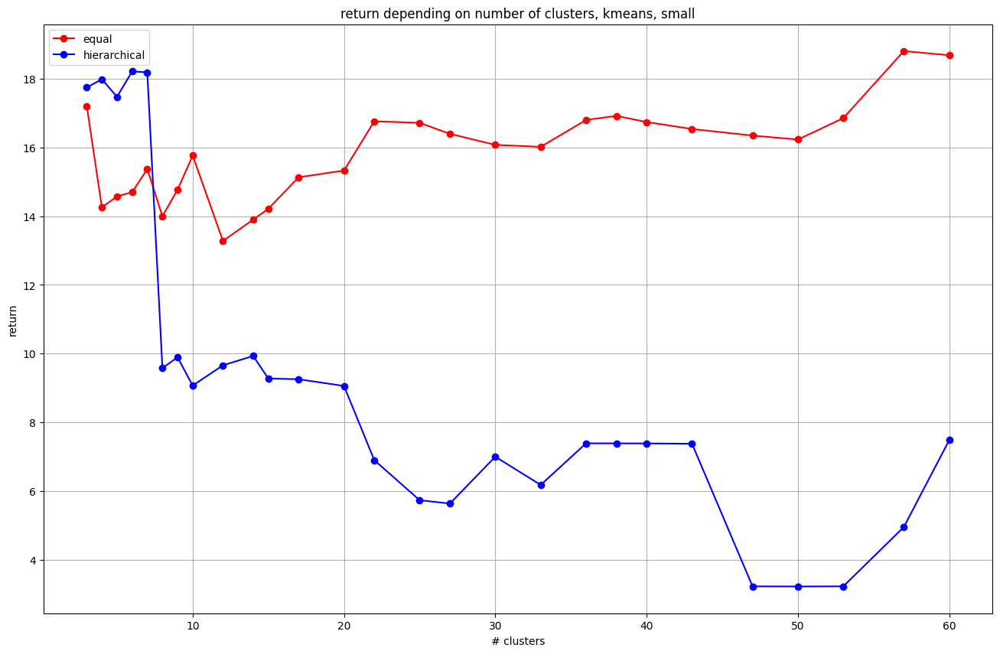

In [106]:
plt.figure(figsize=(16, 10))
plt.plot(num_clusters_array, results_kmeans_equal, marker='o', linestyle='-', color='r', label='equal')
plt.plot(num_clusters_array, results_kmeans_hierarchical, marker='o', linestyle='-', color='b', label='hierarchical')
plt.title('return depending on number of clusters, kmeans, small')
plt.xlabel('# clusters')
plt.ylabel('return')
plt.grid(True)
plt.legend()
plt.show()

In [107]:
results_kmeans_equal = []
for num_clusters in num_clusters_array_big:
    final_weights_kmeans_equal = portfolio_optimization_with_kmeans(train, num_clusters=num_clusters, method='equal')
    returns_kmeans = test.dot(final_weights_kmeans_equal).add(1).cumprod().subtract(1).multiply(100)
    res = returns_kmeans[-1]
    results_kmeans_equal.append(res)

print(results_kmeans_equal)

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/1524842871.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/1524842871.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/1524842871.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipy

[np.float64(17.20823669556626), np.float64(14.257575059130057), np.float64(14.576047052178943), np.float64(14.700614379517063), np.float64(15.37108756210037), np.float64(13.99931604057938), np.float64(14.770768550041558), np.float64(15.765280894288814), np.float64(13.279836981066762), np.float64(13.901828534932514), np.float64(14.21569941251255), np.float64(15.13349577930152), np.float64(15.32850082424524), np.float64(16.76166163611974), np.float64(16.71715400577596), np.float64(16.397050905167454), np.float64(16.075910994855057), np.float64(16.01881009862747), np.float64(16.801483981545818), np.float64(16.91883381116208), np.float64(16.74121755888256), np.float64(16.538248248448827), np.float64(16.346573017464404), np.float64(16.2319217465676), np.float64(16.854177455942466), np.float64(18.80691962015306), np.float64(18.684347786890743), np.float64(18.068565878572016), np.float64(16.710335462840554), np.float64(16.77141437389189), np.float64(17.012276653204793), np.float64(16.85622597

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/1524842871.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



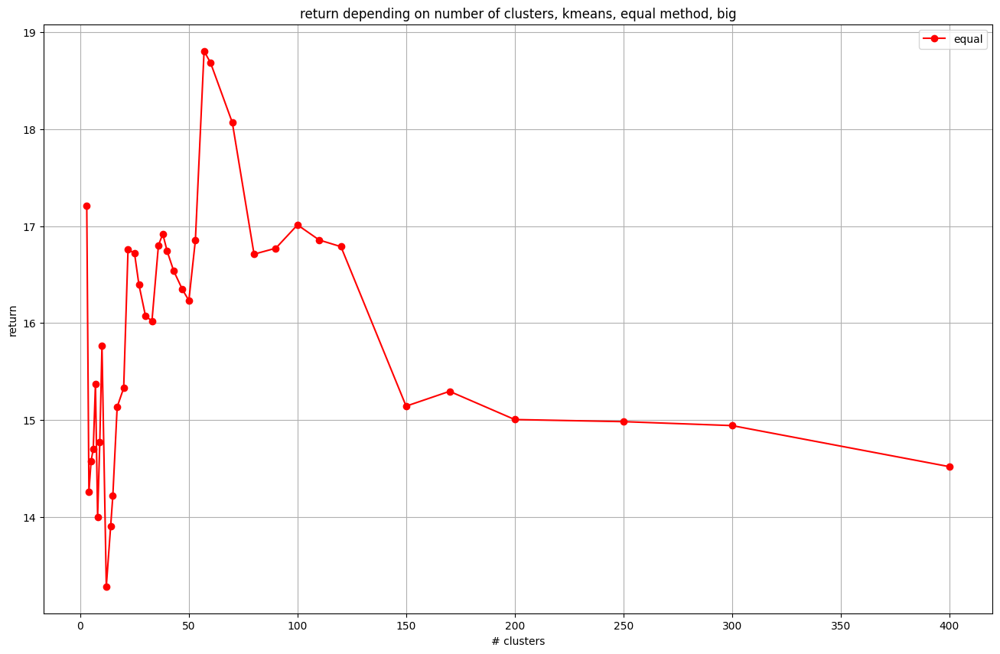

In [108]:
plt.figure(figsize=(16, 10))
plt.plot(num_clusters_array_big, results_kmeans_equal, marker='o', linestyle='-', color='r', label='equal')
plt.title('return depending on number of clusters, kmeans, equal method, big')
plt.xlabel('# clusters')
plt.ylabel('return')
plt.grid(True)
plt.legend()
plt.show()

In [109]:
best_return = -float('inf')
best_cluster_hierarchical = None
for clusters, res in zip(num_clusters_array, results_hierarchical):
    if res > best_return:
        best_return = res
        best_cluster_hierarchical = clusters

best_return = -float('inf')
best_cluster_equal = None
for clusters, res in zip(num_clusters_array_big, results_equal):
    if res > best_return:
        best_return = res
        best_cluster_equal = clusters


best_return = -float('inf')
best_kmeans_hierarchical = None
for clusters, res in zip(num_clusters_array, results_kmeans_hierarchical):
    if res > best_return:
        best_return = res
        best_kmeans_hierarchical = clusters

best_return = -float('inf')
best_kmeans_equal = None
for clusters, res in zip(num_clusters_array_big, results_kmeans_equal):
    if res > best_return:
        best_return = res
        best_kmeans_equal = clusters

print('best_cluster_hierarchical:', best_cluster_hierarchical)
print('best_cluster_equal:', best_cluster_equal)
print('best_kmeans_hierarchical:', best_kmeans_hierarchical)
print('best_kmeans_equal:', best_kmeans_equal)

best_cluster_hierarchical: 36
best_cluster_equal: 90
best_kmeans_hierarchical: 6
best_kmeans_equal: 57


In [110]:
weights_minvar_exp = list(raw_weights_minvar_exp.values())
weights_maxsharpe_exp = list(raw_weights_maxsharpe_exp.values())

num_clusters = 20
final_weights_hierarchical = portfolio_optimization(train, num_clusters=best_cluster_hierarchical, method="hierarchical", visualize=False)
final_weights_equal = portfolio_optimization(train, num_clusters=best_cluster_equal, method="equal", visualize=False)

mean_weights = np.full(train.shape[1], 1 / train.shape[1])
random_weights = np.random.rand(train.shape[1]) 
random_weights /= random_weights.sum()


ret_minvar = test.dot(weights_minvar_exp).add(1).cumprod().subtract(1).multiply(100)
ret_maxsharpe = test.dot(weights_maxsharpe_exp).add(1).cumprod().subtract(1).multiply(100)

ret_hierarchical = test.dot(final_weights_hierarchical).add(1).cumprod().subtract(1).multiply(100)
ret_equal = test.dot(final_weights_equal).add(1).cumprod().subtract(1).multiply(100)

ret_mean = test.dot(mean_weights).add(1).cumprod().subtract(1).multiply(100)
ret_random = test.dot(random_weights).add(1).cumprod().subtract(1).multiply(100)

In [112]:
from skfolio import RiskMeasure
from skfolio.datasets import load_sp500_dataset
from skfolio.optimization import MeanRisk, ObjectiveFunction
from skfolio.preprocessing import prices_to_returns
from skfolio.optimization import RiskBudgeting
from skfolio.optimization import MaximumDiversification
from skfolio.optimization import HierarchicalRiskParity
from skfolio.distance import MutualInformation
import cvxpy as cp

# model_cvar = RiskBudgeting(risk_measure=RiskMeasure.CVAR, solver=cp.SCS)#, solver_params=dict(verbose=True))
# model_cvar.fit(train)
# weights_cvar = model_cvar.weights_
# ret_cvar = test.dot(weights_cvar).add(1).cumprod().subtract(1).multiply(100)

/Users/kiruxalight/course_work/course_work/lib/python3.12/site-packages/skfolio/optimization/convex/_risk_budgeting.py:561: UserWarning:

Solution may be inaccurate. Try changing the solver params or the scale. For more details, set `solver_params=dict(verbose=True)`



In [113]:
# print(ret_cvar)

Date
2022-08-01     30.410374
2022-08-02     -5.311754
2022-08-03      9.867316
2022-08-04    125.698890
2022-08-05    158.318022
                 ...    
2023-12-22   -100.000000
2023-12-26   -100.000000
2023-12-27   -100.000000
2023-12-28   -100.000000
2023-12-29   -100.000000
Length: 365, dtype: float64


In [114]:
model_maxdiv = MaximumDiversification()
model_maxdiv.fit(train)
weights_cvar = model_maxdiv.weights_
ret_maxdiv = test.dot(weights_cvar).add(1).cumprod().subtract(1).multiply(100)

In [117]:
print(ret_maxdiv)

Date
2022-08-01    1.307720
2022-08-02    0.768525
2022-08-03    2.582373
2022-08-04    2.342875
2022-08-05    0.923832
                ...   
2023-12-22    6.158734
2023-12-26    6.581005
2023-12-27    6.976688
2023-12-28    6.196330
2023-12-29    5.752886
Length: 365, dtype: float64


In [115]:
model_hrp = HierarchicalRiskParity(
    risk_measure=RiskMeasure.SEMI_DEVIATION, distance_estimator=MutualInformation()
)
model_hrp.fit(train)
weights_hrp = model_hrp.weights_
ret_hrp = test.dot(weights_hrp).add(1).cumprod().subtract(1).multiply(100)

In [116]:
print(ret_hrp)

Date
2022-08-01    -0.089872
2022-08-02    -0.684609
2022-08-03     0.230299
2022-08-04     0.205723
2022-08-05     0.174647
                ...    
2023-12-22    13.179159
2023-12-26    13.722304
2023-12-27    13.947513
2023-12-28    14.090958
2023-12-29    13.833338
Length: 365, dtype: float64


In [118]:
from skfolio.optimization import NestedClustersOptimization
from skfolio.distance import KendallDistance
from sklearn.model_selection import KFold


model_mixed = NestedClustersOptimization(
    inner_estimator=MeanRisk(risk_measure=RiskMeasure.SEMI_VARIANCE),
    outer_estimator=RiskBudgeting(risk_measure=RiskMeasure.CVAR),
    distance_estimator=KendallDistance(),
    clustering_estimator=KMeans(n_init="auto"),
    cv=KFold(),
    n_jobs=-1,
)
model_mixed.fit(train)
weights_mixed = model_mixed.weights_
ret_mixed = test.dot(weights_mixed).add(1).cumprod().subtract(1).multiply(100)

In [119]:
print(ret_mixed)

Date
2022-08-01    0.216618
2022-08-02   -0.315732
2022-08-03    0.374404
2022-08-04    0.208321
2022-08-05   -0.245272
                ...   
2023-12-22    8.336091
2023-12-26    8.498423
2023-12-27    8.814861
2023-12-28    8.829134
2023-12-29    8.924724
Length: 365, dtype: float64


In [120]:
final_weights_kmeans_hierarchical = portfolio_optimization_with_kmeans(train, num_clusters=best_cluster_hierarchical, method='hierarchical')
ret_kmeans_hierarchical = test.dot(final_weights_kmeans_equal).add(1).cumprod().subtract(1).multiply(100)

final_weights_kmeans_equal = portfolio_optimization_with_kmeans(train, num_clusters=best_cluster_equal, method='equal')
ret_kmeans_equal = test.dot(final_weights_kmeans_equal).add(1).cumprod().subtract(1).multiply(100)

In [121]:
sp_index = yf.download('^GSPC', start=start_date, end=end_date)
# print(sp_index.columns)
snp500_ret = sp_index.loc['2022-07-31':, ('Close', '^GSPC')].pct_change().add(1).cumprod().subtract(1).multiply(100)

[*********************100%***********************]  1 of 1 completed


In [122]:
nasdaq_index = yf.download('^IXIC', start=start_date, end=end_date)
# print(nasdaq_index.columns)
nasdaq_ret = nasdaq_index.loc['2022-07-31':, ('Close', '^IXIC')].pct_change().add(1).cumprod().subtract(1).multiply(100)

[*********************100%***********************]  1 of 1 completed


In [123]:
dax_index = yf.download('^GDAXI', start=start_date, end=end_date)
dax_ret = dax_index.loc['2022-07-31':, ('Close', '^GDAXI')].pct_change().add(1).cumprod().subtract(1).multiply(100)

[*********************100%***********************]  1 of 1 completed


In [127]:
djia_index = yf.download('^DJI', start=start_date, end=end_date)
djia_ret = djia_index.loc['2022-07-31':, ('Close', '^DJI')].pct_change().add(1).cumprod().subtract(1).multiply(100)

[*********************100%***********************]  1 of 1 completed


In [128]:
ftse_index = yf.download('^FTSE', start=start_date, end=end_date)
ftse_ret = ftse_index.loc['2022-07-31':, ('Close', '^FTSE')].pct_change().add(1).cumprod().subtract(1).multiply(100)

[*********************100%***********************]  1 of 1 completed


In [124]:
print(mean_weights)
print(final_weights_equal)
print(train.shape)

[0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414
 0.00172414 0.00172414 0.00172414 0.00172414 0.00172414 0.0017

In [125]:
# print(ret_cluster)

In [131]:
info = pd.DataFrame({
                     "MinVar": ret_minvar, 
                     "MaxSharpe": ret_maxsharpe,
                     "Clustering Hierarchical": ret_hierarchical,
                     "Clustering Equal": ret_equal,
                     "Mean weights": ret_mean,
                     "Random weights": ret_random,
                     "S&P 500 index": snp500_ret,
                    #  "NASDAQ index": nasdaq_ret,
                    #  "DAX index": dax_ret,
                     "DJIA index": djia_ret,
                     "FTSE index": ftse_ret,
                     "kmeans equal": ret_kmeans_equal,
                     "kmeans hierarchical": ret_kmeans_hierarchical,
                    #  "CVaR": ret_cvar,
                     "Maxdiv": ret_maxdiv,
                     "HRP": ret_hrp,
                     "Mixed clustering model": ret_mixed,
                     })
info = pd.concat([info], join="outer", axis=1)
info.drop(info.tail(1).index,inplace=True)

# info.interpolate(method = "linear", inplace = True)

fig = px.line(info, x=info.index, y=info.columns, title="Portfolio Performance")
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Cumulative Return in %')
fig.update_layout(
    width=1300,
    height=700
)

fig.show()

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_40336/940714504.py:6: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



[np.float64(13.446259692239405), np.float64(13.21081884606119), np.float64(12.751775068428772), np.float64(12.971538365333068), np.float64(12.974244564456505), np.float64(12.970719027208478), np.float64(12.973454600155488), np.float64(12.979859918791558), np.float64(12.984963923324532), np.float64(12.98635597265747), np.float64(12.98568202360164), np.float64(13.063955055276644), np.float64(13.084273329289875), np.float64(18.902734358976538), np.float64(17.25258975915782), np.float64(25.84231987196517), np.float64(23.934210883333296)]


In [87]:
# plt.figure(figsize=(16, 10))
# plt.plot(num_clusters_array, results, marker='o', linestyle='-', color='b')
# plt.title('return depending on number of clusters, hierarchical method')
# plt.xlabel('# clusters')
# plt.ylabel('return')
# plt.grid(True)
# plt.show()

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_40336/50598602.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



[np.float64(14.368932223084352), np.float64(13.052374173379743), np.float64(13.995419236241347), np.float64(15.347914652523809), np.float64(14.971000899898112), np.float64(15.682045307986137), np.float64(15.736798022242748), np.float64(16.15362293447069), np.float64(16.43886400264556), np.float64(16.427079364491814), np.float64(16.652921940342026), np.float64(17.456585917777588), np.float64(17.62001459057785), np.float64(15.036831544754925), np.float64(14.900160285914609), np.float64(14.928064459644741), np.float64(15.028557734559822)]


In [308]:
# def compute_metrics(prices: pd.DataFrame,
#                               weights: np.ndarray,
#                               risk_free_rate: float = 0.0,
#                               period: str = 'daily'):
#     df = pd.DataFrame()
#     df['volatility'] = compute_volatility(prices, weights, risk_free_rate, period)

# def compute_volatility(prices: pd.DataFrame,
#                               weights: np.ndarray,
#                               window: int = 40
#                               ):
#     # returns = prices.pct_change().iloc[1:]
#     # returns = returns.replace([np.inf, -np.inf], 0)
#     # weights_ret = returns.dot(weights)
#     # with open('debug3.txt', 'w', encoding='utf-8') as f:
#     #     for i in range(len(weights_ret)):
#     #         f.write(f"{returns.iloc[0][i]} -- {weights[i]}\n")

#     # return weights_ret.rolling(window).std()
#     returns = prices.pct_change().iloc[1:]
#     returns = returns.replace([np.inf, -np.inf], np.nan).fillna(0)
#     weights_ret = returns.dot(weights)
#     return weights_ret.rolling(window).std()
# def compute_volatility2(prices: pd.DataFrame,
#                               weights: np.ndarray,
#                               window: int = 20
#                               ):
#     # returns = prices.pct_change().iloc[1:]
#     # # with open('debug.txt', 'w', encoding='utf-8') as f:
#     # #     for i in range(returns.shape[1]):
#     # #         f.write(f"{weights[i]} -- {returns.iloc[0][i]}\n")
#     # returns2 = prices.dot(weights)
#     # with open('debug2.txt', 'w', encoding='utf-8') as f:
#     #     for i in range(len(returns2)):
#     #         f.write(f"{weights[i]} -- {returns2[i]}\n")
#     # weights_ret = returns.dot(weights)
    
#     # returns3 = prices.dot(weights)
#     # pct_change = 
#     returns = prices.pct_change().iloc[1:]
#     returns = returns.replace([np.inf, -np.inf], np.nan).fillna(0)
#     weights_ret = returns.dot(weights)
#     # print(weights_ret)
#     return weights_ret.std()

# def compute_return(prices: pd.DataFrame,
#                               weights: np.ndarray):
#     # weight_ret = prices.dot(weights).add(1).cumprod()
#     # period_ret = weight_ret.pct_change().iloc[1:]

#     # lol = period_ret.add(1).cumprod()
#     # return (lol[-1] - 1) * 100
#     weight_ret = prices.dot(weights)

# # def compute_return2(prices: pd.DataFrame,
# #                               weights: np.ndarray):
# #     return prices.dot(weights).add(1).cumprod().subtract(1).multiply(100)[-1]



In [309]:
# print(compute_volatility2(test, weights_minvar_exp))
# print(compute_volatility2(test, weights_maxsharpe_exp))
# print(compute_volatility2(test, final_weights_hierarchical))
# print(compute_volatility2(test, final_weights_equal))
# print(compute_volatility2(test, final_weights_kmeans_hierarchical))
# print(compute_volatility2(test, final_weights_kmeans_equal))
# print(compute_volatility2(test, weights_mixed))
# print(compute_volatility2(test, weights_hrp))
# print(compute_volatility2(test, mean_weights))
# print(compute_volatility2(test, random_weights))

1.9376576747296144
14.013611444313929
3.5338837496969435
19.959578242147128
3.227016868255036
17.10430225401044
2.650440691252175
9.131357658364744
18.582855139803204
6.158313612411982


1.2358222065835416


/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/2275688962.py:2: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



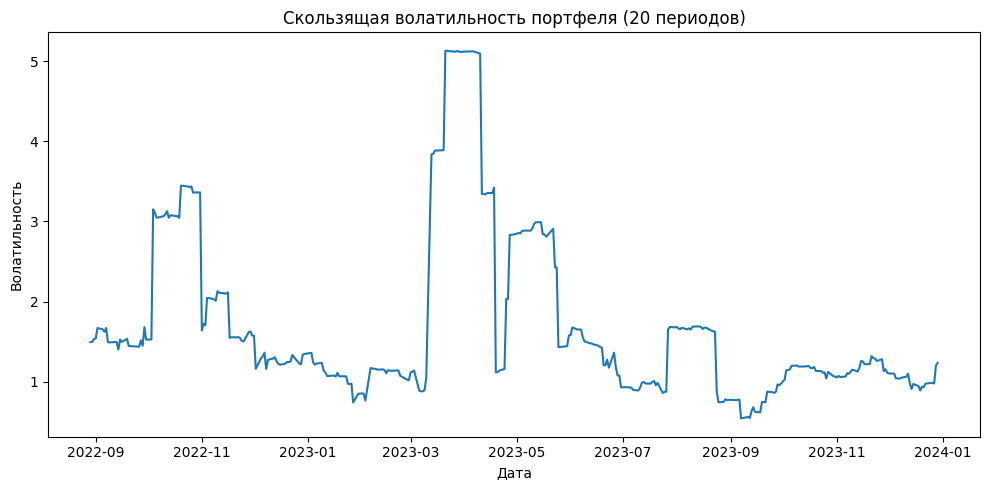

In [310]:
# rolling_vol = compute_volatility(test, weights_minvar_exp, window=20)
# print(rolling_vol[-1])
# # print(rolling_vol[20:])
# # Построим график
# plt.figure(figsize=(10, 5))
# plt.plot(rolling_vol.index, rolling_vol.values)
# plt.title('Скользящая волатильность портфеля (20 периодов)')
# plt.xlabel('Дата')
# plt.ylabel('Волатильность')
# plt.tight_layout()
# plt.show()

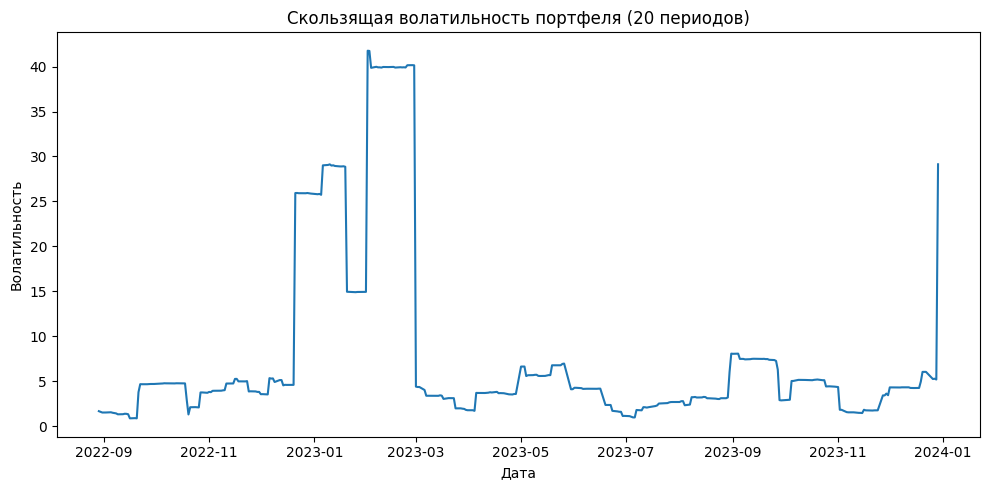

In [311]:
# rolling_vol = compute_volatility(test, weights_maxsharpe_exp, window=20)
# # print(rolling_vol[20:])
# # Построим график
# plt.figure(figsize=(10, 5))
# plt.plot(rolling_vol.index, rolling_vol.values)
# plt.title('Скользящая волатильность портфеля (20 периодов)')
# plt.xlabel('Дата')
# plt.ylabel('Волатильность')
# plt.tight_layout()
# plt.show()

3.1199021282978334


/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/2945485809.py:2: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



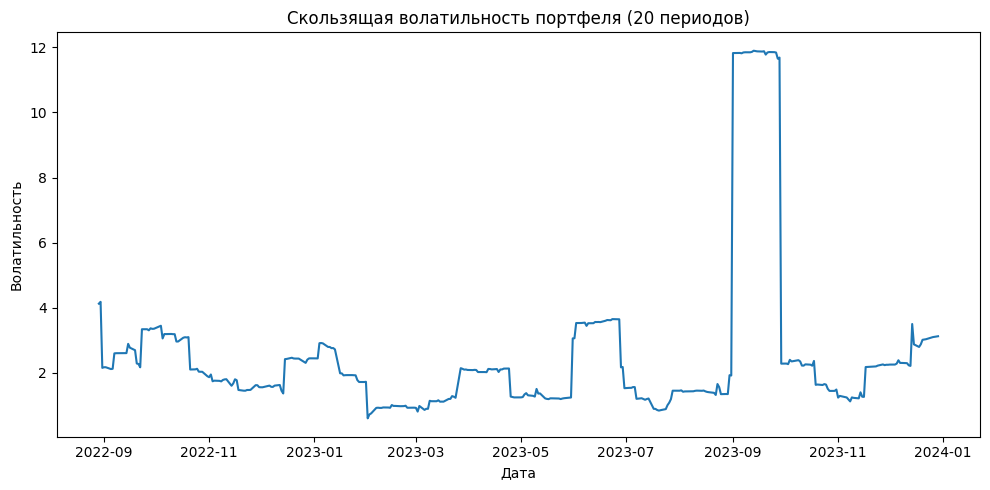

In [312]:
# rolling_vol = compute_volatility(test, final_weights_hierarchical, window=20)
# print(rolling_vol[-1])
# # print(rolling_vol[20:])
# # Построим график
# plt.figure(figsize=(10, 5))
# plt.plot(rolling_vol.index, rolling_vol.values)
# plt.title('Скользящая волатильность портфеля (20 периодов)')
# plt.xlabel('Дата')
# plt.ylabel('Волатильность')
# plt.tight_layout()
# plt.show()

In [215]:
# # print(compute_volatility(test, weights_minvar_exp))
# # print(compute_volatility(test, weights_maxsharpe_exp))
# # print(compute_volatility(test, weights_mixed))
# print(compute_return(test, weights_minvar_exp))
# print(compute_return(test, weights_maxsharpe_exp))

# #ret_mixed = test.dot(weights_mixed).add(1).cumprod().subtract(1).multiply(100)

0.0018141424297168425
0.008669101417148722
0.0056836184844907805
8.970843007398322
8.251282205490451


/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/1009145103.py:20: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



In [372]:
def compute_volatility(prices: pd.DataFrame,
                              weights: np.ndarray,
                              ):
    returns = prices.pct_change().iloc[1:]
    returns = returns.replace([np.inf, -np.inf], np.nan).fillna(0)
    # prices_clean = prices.replace([np.inf, -np.inf], np.nan)
    # prices_clean = prices_clean.fillna(method='ffill').fillna(method='bfill')
    # returns = prices_clean.pct_change().iloc[1:]
    # returns = returns.replace([np.inf, -np.inf], np.nan).fillna(0)

    weights_ret = returns.dot(weights)
    return weights_ret.std()

def get_portfolio_returns(prices: pd.DataFrame,
                          weights: np.ndarray) -> pd.Series:
    returns = prices.pct_change().iloc[1:]\
                    .replace([np.inf, -np.inf], np.nan)\
                    .fillna(0)
    return returns.dot(weights)

def compute_sharpe(prices: pd.DataFrame,
                   weights: np.ndarray,
                   risk_free_rate: float = 0.0,
                   period: str = 'daily') -> float:
    returns = prices.pct_change().iloc[1:]
    returns = returns.replace([np.inf, -np.inf], np.nan).fillna(0)
    returns = returns.dot(weights)

    mean_return = returns.mean()
    std_return = returns.std(ddof=1)
    return (mean_return - risk_free_rate) / std_return


def compute_cumreturn(prices: pd.DataFrame,
                      weights: np.ndarray) -> float:
    return prices.dot(weights).add(1).cumprod().subtract(1).multiply(100)[-1]

def compute_sortino(prices: pd.DataFrame,
                    weights: np.ndarray,
                    required_return: float = 0.0) -> float:
    returns = prices.pct_change().iloc[1:] \
                    .replace([np.inf, -np.inf], np.nan) \
                    .fillna(0)
    port_ret = returns.dot(weights)
    mean_return = port_ret.mean()
    downside = port_ret[port_ret < required_return]
    std_downside = downside.std(ddof=1)
    return (mean_return - required_return) / std_downside


# def compute_drawdown_durations(prices: pd.DataFrame,
#                                weights: np.ndarray) -> tuple[int, float]:
#     returns = prices.pct_change().iloc[1:] \
#                     .replace([np.inf, -np.inf], np.nan) \
#                     .fillna(0)
#     port_ret = returns.dot(weights)
#     equity = (1 + port_ret).cumprod()
#     running_max = equity.cummax()
#     in_dd = equity < running_max

#     durations = []
#     current = 0
#     for flag in in_dd:
#         if flag:
#             current += 1
#         elif current > 0:
#             durations.append(current)
#             current = 0
#     if current > 0:
#         durations.append(current)

#     if len(durations) == 0:
#         return 0, 0.0

#     max_dur = max(durations)
#     avg_dur = float(np.mean(durations))
#     return max_dur, avg_dur

def compute_ulcer_index(prices: pd.DataFrame,
                        weights: np.ndarray) -> float:
    returns = prices.pct_change().iloc[1:] \
                    .replace([np.inf, -np.inf], np.nan) \
                    .fillna(0)
    port_ret = returns.dot(weights)
    equity = (1 + port_ret).cumprod()
    equity = pd.concat([pd.Series([1.0], index=[prices.index[0]]), equity])
    running_max = equity.cummax()
    drawdowns = (equity - running_max) / running_max
    ui = np.sqrt(np.mean(drawdowns ** 2))
    return ui

def collect_metrics(prices: pd.DataFrame,
                              weights: np.ndarray):
    metrics = {}
    metrics['return'] = compute_cumreturn(prices, weights)
    metrics['volatility'] = compute_volatility(prices, weights)
    metrics['sharpe'] = compute_sharpe(prices, weights)
    metrics['sortino'] = compute_sortino(prices, weights)
    # drawdown_duration = compute_drawdown_durations(prices, weights)
    # metrics['max_drawdown_duration'] = drawdown_duration[0]
    # metrics['mean_drawdown_duration'] = drawdown_duration[1]
    metrics['ulcer_index'] = compute_ulcer_index(prices, weights)
    return metrics

In [373]:
methods = {
    'Minimum Variance': weights_minvar_exp,
    'Maximum Sharpe': weights_maxsharpe_exp,
    'Clustering Hierarchical': final_weights_hierarchical,
    'Clustering Equal': final_weights_equal,
    'K-means Hierarchical': final_weights_kmeans_hierarchical,
    'K-means Equal': final_weights_kmeans_equal,
    'Mixed': weights_mixed,
    'HRP': weights_hrp,
    'Mean Weights': mean_weights,
    'Random Weights': random_weights
}

metrics_df = pd.DataFrame(columns=['Cumulative Return', 
                                   'Volatility', 
                                   'Sharpe', 
                                   'Sortino', 
                                #    'Max Drawdown Duration', 
                                #    'Mean Drawdown Duration', 
                                #    'Ulcer Index'
                                   ])

metrics_df = pd.DataFrame(index=methods.keys(), columns=['Cumulative Return', 
                                                         'Volatility', 
                                                         'Sharpe', 
                                                         'Sortino', 
                                                        #  'Max Drawdown Duration', 
                                                        #  'Mean Drawdown Duration', 
                                                        #  'Ulcer Index'
                                                         ])
for method_name, weights in methods.items():
    metrics = collect_metrics(test, weights)
    metrics_df.loc[method_name, 'Cumulative Return'] = metrics['return']
    metrics_df.loc[method_name, 'Volatility'] = metrics['volatility']
    metrics_df.loc[method_name, 'Sharpe'] = metrics['sharpe']
    metrics_df.loc[method_name, 'Sortino'] = metrics['sortino']
    # metrics_df.loc[method_name, 'Max Drawdown Duration'] = metrics['max_drawdown_duration']
    # metrics_df.loc[method_name, 'Mean Drawdown Duration'] = metrics['mean_drawdown_duration']
    # metrics_df.loc[method_name, 'Ulcer Index'] = metrics['ulcer_index']
display(metrics_df)

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/692965269.py:36: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



,Cumulative Return,Volatility,Sharpe,Sortino
Minimum Variance,9.202903,1.937658,-0.449761,-0.577932
Maximum Sharpe,7.855692,14.013611,0.045179,0.22464
Clustering Hierarchical,22.773295,3.533884,-0.320067,-0.323243
Clustering Equal,17.781328,19.959578,0.001408,0.024463
K-means Hierarchical,7.389939,3.227017,-0.305336,-0.343063
K-means Equal,16.771414,17.104302,-0.004183,-0.075544
Mixed,8.924724,2.650441,-0.451597,-0.458366
HRP,13.833338,9.131358,-0.058939,-0.493331
Mean Weights,16.51432,18.582855,-0.000767,-0.012986
Random Weights,17.056352,6.158314,-0.117039,-0.432741


In [369]:
print(len(test))

365


In [343]:
snp500_index = pd.DataFrame(sp_index.loc['2022-07-31':, ('Close', '^GSPC')])
# print(compute_volatility(snp500_index, np.array([1.0])))
# print(compute_volatility())
print(collect_metrics(snp500_index, np.array([1.0])))

{'return': np.float64(inf), 'volatility': np.float64(0.010731795506422219), 'sharpe': np.float64(0.04377038218176893)}


/Users/kiruxalight/course_work/course_work/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:57: RuntimeWarning:

overflow encountered in accumulate

/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_76794/3732858613.py:31: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



In [167]:
price_data['GEHC'].tail(50)

KeyError: 'GEHC'

In [36]:
returns['GEHC'].head(50)

Date
2020-01-03 00:00:00+00:00    0.0
2020-01-06 00:00:00+00:00    0.0
2020-01-07 00:00:00+00:00    0.0
2020-01-08 00:00:00+00:00    0.0
2020-01-09 00:00:00+00:00    0.0
2020-01-10 00:00:00+00:00    0.0
2020-01-13 00:00:00+00:00    0.0
2020-01-14 00:00:00+00:00    0.0
2020-01-15 00:00:00+00:00    0.0
2020-01-16 00:00:00+00:00    0.0
2020-01-17 00:00:00+00:00    0.0
2020-01-20 00:00:00+00:00    0.0
2020-01-21 00:00:00+00:00    0.0
2020-01-22 00:00:00+00:00    0.0
2020-01-23 00:00:00+00:00    0.0
2020-01-24 00:00:00+00:00    0.0
2020-01-27 00:00:00+00:00    0.0
2020-01-28 00:00:00+00:00    0.0
2020-01-29 00:00:00+00:00    0.0
2020-01-30 00:00:00+00:00    0.0
2020-01-31 00:00:00+00:00    0.0
2020-02-03 00:00:00+00:00    0.0
2020-02-04 00:00:00+00:00    0.0
2020-02-05 00:00:00+00:00    0.0
2020-02-06 00:00:00+00:00    0.0
2020-02-07 00:00:00+00:00    0.0
2020-02-10 00:00:00+00:00    0.0
2020-02-11 00:00:00+00:00    0.0
2020-02-12 00:00:00+00:00    0.0
2020-02-13 00:00:00+00:00    0.0
2020-